In [1]:
!pip install pysd==0.9.0
!pip install pandas
!pip install numpy
!pip install matplotlib

In [2]:
import pandas as pd 
import matplotlib.pyplot as plt
import pysd
import numpy as np

In [3]:
model = pysd.read_vensim('modelo.mdl')
stocks = model.run() # nos arroja los valores de todas las variables del modelo .mdl
print(stocks)
PanelPrice=[0.9,1,1.1,1.2,1.3]
demandGrowth=np.linspace(0.0, 0.06, 6)
gasEstacions=10000
evsIncentive=np.linspace(0.8, 1, 6)
restriccioMovilidad=[1,1.3,1.6,2,2.3]
impuestoEmision=np.arange(1, 2.25, 0.25)
print(impuestoEmision)

resultados = []
df_resultados = pd.DataFrame()
gasEstacionsF=[0.8,0.9,1,1.1,1.2]

              TIME  tasa adopción  Impuesto de emisión  Restriccion movilidad  \
2024.000  2024.000       0.030255                    1                      1   
2024.125  2024.125    1248.260405                    1                      1   
2024.250  2024.250    2457.729299                    1                      1   
2024.375  2024.375    3630.382577                    1                      1   
2024.500  2024.500    4767.370848                    1                      1   
...            ...            ...                  ...                    ...   
2049.500  2049.500  108697.016902                    1                      1   
2049.625  2049.625  108530.062578                    1                      1   
2049.750  2049.750  108360.636940                    1                      1   
2049.875  2049.875  108188.869860                    1                      1   
2050.000  2050.000  108014.883682                    1                      1   

          Incentivo vehícul

C:\Users\Anime\AppData\Local\Temp\ipykernel_26560\1398546807.py:21: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_resultados[f'CO2 Emissions Scenario {w}'] = stocks['CO2 Emissions']
C:\Users\Anime\AppData\Local\Temp\ipykernel_26560\1398546807.py:22: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_resultados[f'Electric Vehicles Scenario {w}'] = stocks['Electric Vehicles']
C:\Users\Anime\AppData\Local\Temp\ipykernel_26560\1398546807.py:23: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calli

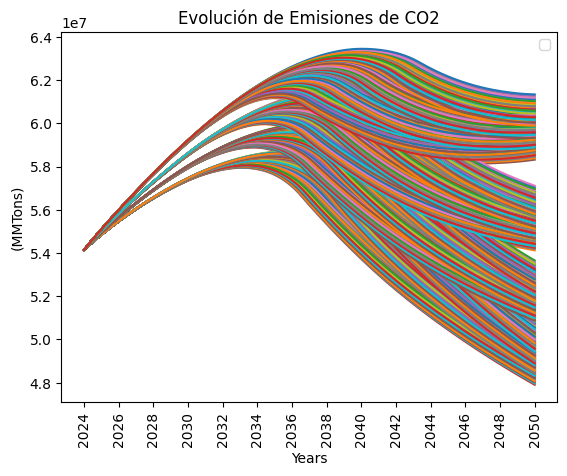

In [4]:
plt.figure(1)
w=0
for i in range(0, 4):
    for j in range(0,4):
        for k in range(0,4):
            for l in range(0,4):
                for m in range(0,4):
                    for n in range(0,4):
                        stocks = model.run(
                        params={
                        'Panel price': PanelPrice[i],
                        'incremento promedio de la demanda': demandGrowth[j],
                        'Estaciones de gasolina': gasEstacions*gasEstacionsF[k],
                        'Incentivo vehículo electico': evsIncentive[l],
                        'Impuesto de emisión': impuestoEmision[m],
                        'Restriccion movilidad':restriccioMovilidad[n],
                        'TIME STEP': 0.125},
                        return_columns=['CO2 Emissions', 'Electric Vehicles', 
                        'Household PV adopters','TIME']
                )
                    df_resultados[f'CO2 Emissions Scenario {w}'] = stocks['CO2 Emissions']
                    df_resultados[f'Electric Vehicles Scenario {w}'] = stocks['Electric Vehicles']
                    df_resultados[f'Household PV adopters Scenario {w}'] = stocks['Household PV adopters']
                    df_resultados[f'Panel Price Scenario {w}'] = PanelPrice[i]
                    df_resultados[f'Demand Growth Scenario {w}'] = demandGrowth[j]
                    df_resultados[f'Gas Stations Scenario {w}'] = gasEstacions * gasEstacionsF[k]
                    df_resultados[f'EV Incentive Scenario {w}'] = evsIncentive[l]
                    df_resultados[f'Emissions Tax Scenario {w}'] = impuestoEmision[m]
                    df_resultados[f'Mobility Restriction Scenario {w}'] = restriccioMovilidad[n]
                    df_resultados['TIME'] = stocks['TIME']
                    w=w+1
    # Graficar CO2 Emissions
                    plt.plot(stocks["TIME"], stocks["CO2 Emissions"]
                     )
    
plt.ylabel('(MMTons)')
plt.xticks(np.arange(2024, 2050 + 1, 2)) 
plt.xlabel('Years')
plt.title('Evolución de Emisiones de CO2')
plt.legend()  # Añadir la leyenda para diferenciar cada línea
plt.xticks(rotation=90)
plt.show()

#df_resultados = pd.DataFrame(resultados, columns=[  'Time', 'CO2 Emissions', 'Electric Vehicles','Household PV adopters'])

#df_resultados.to_excel('resultados_simulacion.xlsx', index=False)
df_resultados.to_pickle('resultados_simulacion.pkl')


In [5]:
df_resultados.info()

<class 'pandas.core.frame.DataFrame'>
Index: 209 entries, 2024.0 to 2050.0
Columns: 9217 entries, CO2 Emissions Scenario 0 to Mobility Restriction Scenario 1023
dtypes: float64(7681), int64(1536)
memory usage: 14.7 MB


In [6]:
# Filtrar el DataFrame para obtener solo los datos del año 2050
df_2050 = df_resultados[df_resultados['TIME'] == 2050]

# Verificar los datos del año 2050
df_2050.head()


,CO2 Emissions Scenario 0,Electric Vehicles Scenario 0,Household PV adopters Scenario 0,Panel Price Scenario 0,Demand Growth Scenario 0,Gas Stations Scenario 0,EV Incentive Scenario 0,Emissions Tax Scenario 0,Mobility Restriction Scenario 0,TIME,...,Mobility Restriction Scenario 1022,CO2 Emissions Scenario 1023,Electric Vehicles Scenario 1023,Household PV adopters Scenario 1023,Panel Price Scenario 1023,Demand Growth Scenario 1023,Gas Stations Scenario 1023,EV Incentive Scenario 1023,Emissions Tax Scenario 1023,Mobility Restriction Scenario 1023
2050.0,4.872594e+07,1.296578e+06,3.929931e+06,0.9,0.0,8000.0,0.8,1.0,2,2050.0,...,2,6.029028e+07,1.152239e+06,3.314896e+06,1.2,0.036,11000.0,0.92,1.75,2


In [7]:
# Filtrar solo las columnas de 'CO2 Emissions' en el año 2050
co2_columns = [col for col in df_2050.columns if 'CO2 Emissions Scenario' in col]

# Encontrar el índice de la columna con la menor y mayor emisión de CO2
best_co2_col = df_2050[co2_columns].idxmin(axis=1).values[0]
worst_co2_col = df_2050[co2_columns].idxmax(axis=1).values[0]

# Obtener los parámetros del mejor y peor escenario de emisiones de CO2
best_co2_params = df_resultados.loc[df_resultados['TIME'] == 2050, [col for col in df_resultados.columns if f'Scenario {best_co2_col.split()[-1]}' in col]].iloc[0]
worst_co2_params = df_resultados.loc[df_resultados['TIME'] == 2050, [col for col in df_resultados.columns if f'Scenario {worst_co2_col.split()[-1]}' in col]].iloc[0]

print("\nParámetros del mejor escenario de emisiones de CO2:")
print(best_co2_params)
print("\nParámetros del peor escenario de emisiones de CO2:")
print(worst_co2_params)




Parámetros del mejor escenario de emisiones de CO2:
CO2 Emissions Scenario 3             4.790271e+07
Electric Vehicles Scenario 3         1.408358e+06
Household PV adopters Scenario 3     3.930862e+06
Panel Price Scenario 3               9.000000e-01
Demand Growth Scenario 3             0.000000e+00
                                         ...     
Demand Growth Scenario 399           2.400000e-02
Gas Stations Scenario 399            8.000000e+03
EV Incentive Scenario 399            9.200000e-01
Emissions Tax Scenario 399           1.750000e+00
Mobility Restriction Scenario 399    2.000000e+00
Name: 2050.0, Length: 999, dtype: float64

Parámetros del peor escenario de emisiones de CO2:
CO2 Emissions Scenario 1020            6.134150e+07
Electric Vehicles Scenario 1020        1.009490e+06
Household PV adopters Scenario 1020    3.313787e+06
Panel Price Scenario 1020              1.200000e+00
Demand Growth Scenario 1020            3.600000e-02
Gas Stations Scenario 1020             1.10

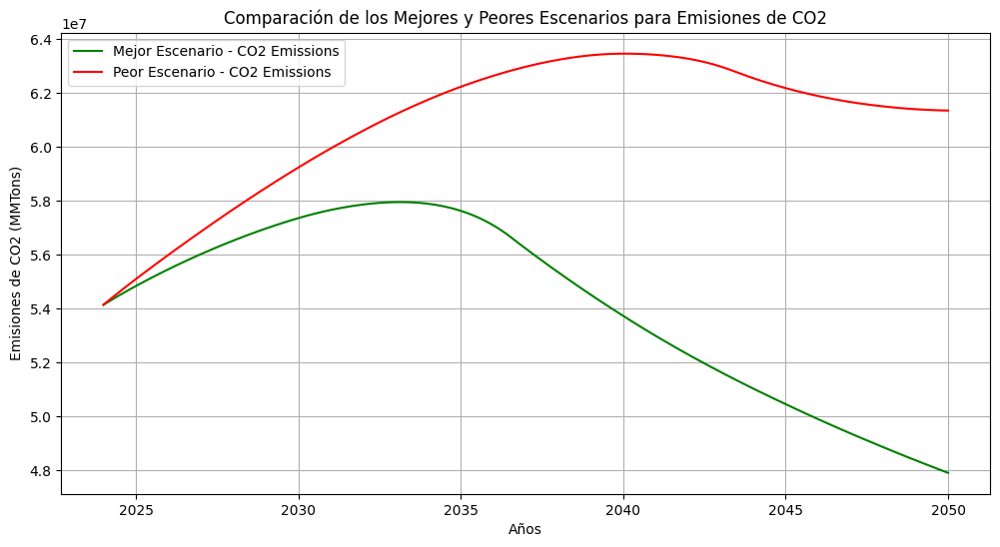

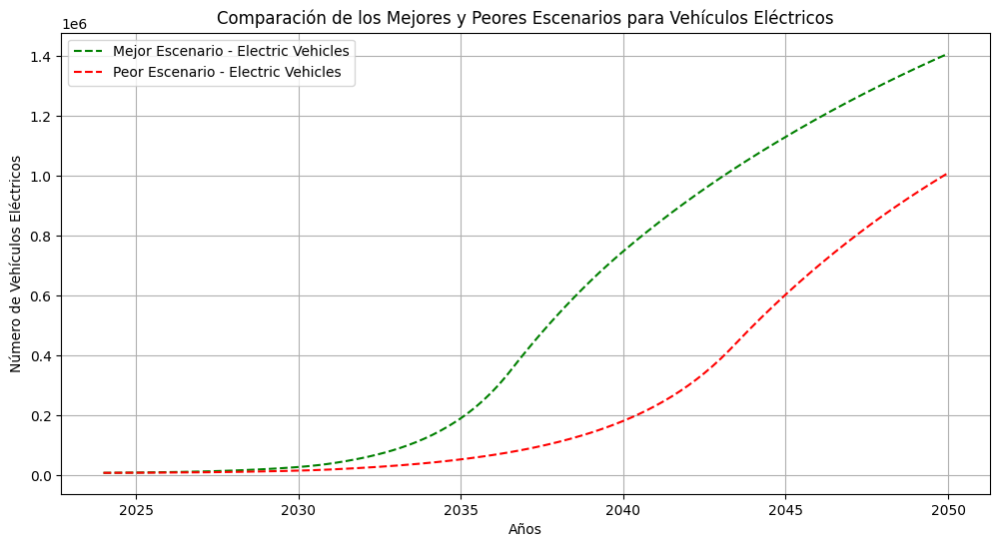

In [8]:
# Definir los valores de los parámetros del mejor escenario
best_params = {
    'Panel price': best_co2_params['Panel Price Scenario ' + best_co2_col.split()[-1]],
    'incremento promedio de la demanda': best_co2_params['Demand Growth Scenario ' + best_co2_col.split()[-1]],
    'Estaciones de gasolina': best_co2_params['Gas Stations Scenario ' + best_co2_col.split()[-1]],
    'Incentivo vehículo electico': best_co2_params['EV Incentive Scenario ' + best_co2_col.split()[-1]],
    'Impuesto de emisión': best_co2_params['Emissions Tax Scenario ' + best_co2_col.split()[-1]],
    'Restriccion movilidad': best_co2_params['Mobility Restriction Scenario ' + best_co2_col.split()[-1]],
    'TIME STEP': 0.125
}

# Volver a correr el modelo con los parámetros del mejor escenario
best_stocks = model.run(params=best_params, return_columns=['CO2 Emissions', 'Electric Vehicles', 'TIME'])

# Definir los valores de los parámetros del peor escenario
worst_params = {
    'Panel price': worst_co2_params['Panel Price Scenario ' + worst_co2_col.split()[-1]],
    'incremento promedio de la demanda': worst_co2_params['Demand Growth Scenario ' + worst_co2_col.split()[-1]],
    'Estaciones de gasolina': worst_co2_params['Gas Stations Scenario ' + worst_co2_col.split()[-1]],
    'Incentivo vehículo electico': worst_co2_params['EV Incentive Scenario ' + worst_co2_col.split()[-1]],
    'Impuesto de emisión': worst_co2_params['Emissions Tax Scenario ' + worst_co2_col.split()[-1]],
    'Restriccion movilidad': worst_co2_params['Mobility Restriction Scenario ' + worst_co2_col.split()[-1]],
    'TIME STEP': 0.125
}

# Volver a correr el modelo con los parámetros del peor escenario
worst_stocks = model.run(params=worst_params, return_columns=['CO2 Emissions', 'Electric Vehicles', 'TIME'])

# Gráfica 1: Evolución de las Emisiones de CO2
plt.figure(figsize=(12, 6))
plt.plot(best_stocks['TIME'], best_stocks['CO2 Emissions'], label='Mejor Escenario - CO2 Emissions', color='green')
plt.plot(worst_stocks['TIME'], worst_stocks['CO2 Emissions'], label='Peor Escenario - CO2 Emissions', color='red')

# Configurar las etiquetas y el título para las emisiones de CO2
plt.xlabel('Años')
plt.ylabel('Emisiones de CO2 (MMTons)')
plt.title('Comparación de los Mejores y Peores Escenarios para Emisiones de CO2')
plt.legend()
plt.grid(True)
plt.show()

# Gráfica 2: Evolución del Número de Vehículos Eléctricos
plt.figure(figsize=(12, 6))
plt.plot(best_stocks['TIME'], best_stocks['Electric Vehicles'], label='Mejor Escenario - Electric Vehicles', linestyle='--', color='green')
plt.plot(worst_stocks['TIME'], worst_stocks['Electric Vehicles'], label='Peor Escenario - Electric Vehicles', linestyle='--', color='red')

# Configurar las etiquetas y el título para los vehículos eléctricos
plt.xlabel('Años')
plt.ylabel('Número de Vehículos Eléctricos')
plt.title('Comparación de los Mejores y Peores Escenarios para Vehículos Eléctricos')
plt.legend()
plt.grid(True)
plt.show()

C:\Users\Anime\AppData\Local\Temp\ipykernel_26560\734545558.py:22: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_resultados2[f'CO2 Emissions Scenario {w}'] = stocks['CO2 Emissions']
C:\Users\Anime\AppData\Local\Temp\ipykernel_26560\734545558.py:23: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_resultados2[f'Electric Vehicles Scenario {w}'] = stocks['Electric Vehicles']
C:\Users\Anime\AppData\Local\Temp\ipykernel_26560\734545558.py:24: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of callin

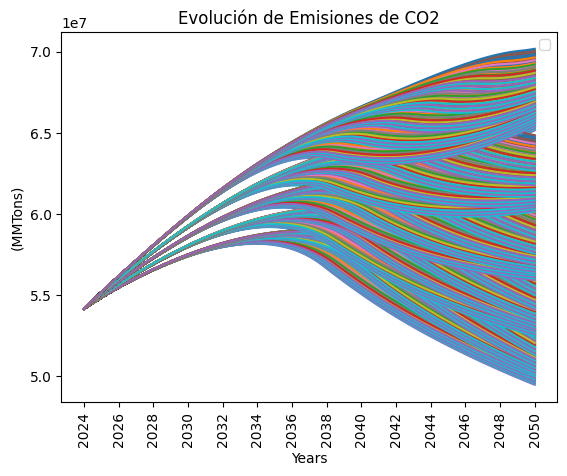

In [9]:
plt.figure(1)
df_resultados2 = pd.DataFrame()
w=0
for i in range(0, len(PanelPrice)):
    for j in range(0, len(PanelPrice)):
        for k in range(0, len(PanelPrice)):
            for l in range(0, len(PanelPrice)):
                for m in range(0, len(PanelPrice)):
                    for n in range(0, len(PanelPrice)):
                        stocks = model.run(
                        params={
                        'Panel price': PanelPrice[i],
                        'incremento promedio de la demanda': demandGrowth[j],
                        'Estaciones de gasolina': gasEstacions*gasEstacionsF[k],
                        'Incentivo vehículo electico': evsIncentive[l],
                        'Impuesto de emisión': impuestoEmision[m],
                        'Restriccion movilidad':restriccioMovilidad[n],
                        'TIME STEP': 0.125},
                        return_columns=['CO2 Emissions', 'Electric Vehicles', 
                        'Household PV adopters','TIME']
                )
                    df_resultados2[f'CO2 Emissions Scenario {w}'] = stocks['CO2 Emissions']
                    df_resultados2[f'Electric Vehicles Scenario {w}'] = stocks['Electric Vehicles']
                    df_resultados2[f'Household PV adopters Scenario {w}'] = stocks['Household PV adopters']
                    df_resultados2[f'Panel Price Scenario {w}'] = PanelPrice[i]
                    df_resultados2[f'Demand Growth Scenario {w}'] = demandGrowth[j]
                    df_resultados2[f'Gas Stations Scenario {w}'] = gasEstacions * gasEstacionsF[k]
                    df_resultados2[f'EV Incentive Scenario {w}'] = evsIncentive[l]
                    df_resultados2[f'Emissions Tax Scenario {w}'] = impuestoEmision[m]
                    df_resultados2[f'Mobility Restriction Scenario {w}'] = restriccioMovilidad[n]
                    df_resultados2['TIME'] = stocks['TIME']
                    w=w+1
    # Graficar CO2 Emissions
                    plt.plot(stocks["TIME"], stocks["CO2 Emissions"]
                     )
    
plt.ylabel('(MMTons)')
plt.xticks(np.arange(2024, 2050 + 1, 2)) 
plt.xlabel('Years')
plt.title('Evolución de Emisiones de CO2')
plt.legend()  # Añadir la leyenda para diferenciar cada línea
plt.xticks(rotation=90)
plt.show()

#df_resultados = pd.DataFrame(resultados, columns=[  'Time', 'CO2 Emissions', 'Electric Vehicles','Household PV adopters'])

#df_resultados.to_excel('resultados_simulacion.xlsx', index=False)
df_resultados2.to_pickle('resultados_simulacion2.pkl')

In [10]:
# Filtrar el DataFrame para obtener solo los datos del año 2050
df_2050 = df_resultados2[df_resultados2['TIME'] == 2050]

# Verificar los datos del año 2050
df_2050.head()

,CO2 Emissions Scenario 0,Electric Vehicles Scenario 0,Household PV adopters Scenario 0,Panel Price Scenario 0,Demand Growth Scenario 0,Gas Stations Scenario 0,EV Incentive Scenario 0,Emissions Tax Scenario 0,Mobility Restriction Scenario 0,TIME,...,Mobility Restriction Scenario 3123,CO2 Emissions Scenario 3124,Electric Vehicles Scenario 3124,Household PV adopters Scenario 3124,Panel Price Scenario 3124,Demand Growth Scenario 3124,Gas Stations Scenario 3124,EV Incentive Scenario 3124,Emissions Tax Scenario 3124,Mobility Restriction Scenario 3124
2050.0,5.038040e+07,1.071926e+06,3.928114e+06,0.9,0.0,8000.0,0.8,1.0,2.3,2050.0,...,2.3,6.851496e+07,752637.557619,3.046463e+06,1.3,0.048,12000.0,0.96,2.0,2.3


In [11]:
df_resultados2.info()

<class 'pandas.core.frame.DataFrame'>
Index: 209 entries, 2024.0 to 2050.0
Columns: 28126 entries, CO2 Emissions Scenario 0 to Mobility Restriction Scenario 3124
dtypes: float64(26876), int64(1250)
memory usage: 44.8 MB


In [12]:
# Filtrar solo las columnas de 'CO2 Emissions' en el año 2050
co2_columns = [col for col in df_2050.columns if 'CO2 Emissions Scenario' in col]

# Encontrar el índice de la columna con la menor y mayor emisión de CO2
best_co2_col = df_2050[co2_columns].idxmin(axis=1).values[0]
worst_co2_col = df_2050[co2_columns].idxmax(axis=1).values[0]

# Obtener los parámetros del mejor y peor escenario de emisiones de CO2
best_co2_params = df_resultados2.loc[df_resultados2['TIME'] == 2050, [col for col in df_resultados2.columns if f'Scenario {best_co2_col.split()[-1]}' in col]].iloc[0]
worst_co2_params = df_resultados2.loc[df_resultados2['TIME'] == 2050, [col for col in df_resultados2.columns if f'Scenario {worst_co2_col.split()[-1]}' in col]].iloc[0]

print("\nParámetros del mejor escenario de emisiones de CO2:")
print(best_co2_params)
print("\nParámetros del peor escenario de emisiones de CO2:")
print(worst_co2_params)


Parámetros del mejor escenario de emisiones de CO2:
CO2 Emissions Scenario 4             4.948308e+07
Electric Vehicles Scenario 4         1.193766e+06
Household PV adopters Scenario 4     3.929145e+06
Panel Price Scenario 4               9.000000e-01
Demand Growth Scenario 4             0.000000e+00
                                         ...     
Demand Growth Scenario 499           3.600000e-02
Gas Stations Scenario 499            1.200000e+04
EV Incentive Scenario 499            9.600000e-01
Emissions Tax Scenario 499           2.000000e+00
Mobility Restriction Scenario 499    2.300000e+00
Name: 2050.0, Length: 999, dtype: float64

Parámetros del peor escenario de emisiones de CO2:
CO2 Emissions Scenario 3120            7.017059e+07
Electric Vehicles Scenario 3120        5.277619e+05
Household PV adopters Scenario 3120    3.045501e+06
Panel Price Scenario 3120              1.300000e+00
Demand Growth Scenario 3120            4.800000e-02
Gas Stations Scenario 3120             1.20